In [179]:
import numpy as np
import matplotlib.pyplot as plt
import cv2, sys,math


# Visualización de las principales características de la imagen

En primer lugar se debe cargar la imagen que se utilizará, para ello se declara el nombre del archivo en una variable ya que se utilizará mas de una vez en todo el notebook, tambien se imprimen las pricipales características de la imagen los cuales son el ancho y la altura y se muestran las primeras dos imagenes que salen al momento de leer el archivo, los cuales son la imagen: la imagen que se lee que esta en formato GBR por lo cual el color azul y rojo estan al reves, esto causa que lo que es de color rojo sea azul y viceverse; Por último se tiene la imagen en formato RGB la cual sería la imagen original.

In [180]:
file_name = "car1.jpeg"

In [181]:
frame = cv2.imread(file_name)
height = frame.shape[0]
width = frame.shape[1]
print(frame.shape)
print("Altura de imagen: ", height)
print("Ancho de imagen: ", width)

(900, 1600, 3)
Altura de imagen:  900
Ancho de imagen:  1600


Cabe recalcar que las imagenes son matrices de listas, donde cada lista de la matriz representa un pixel, esta lista es de tres valores los cuales representa cada uno un canal de color, el rojo, el verde y el azul.

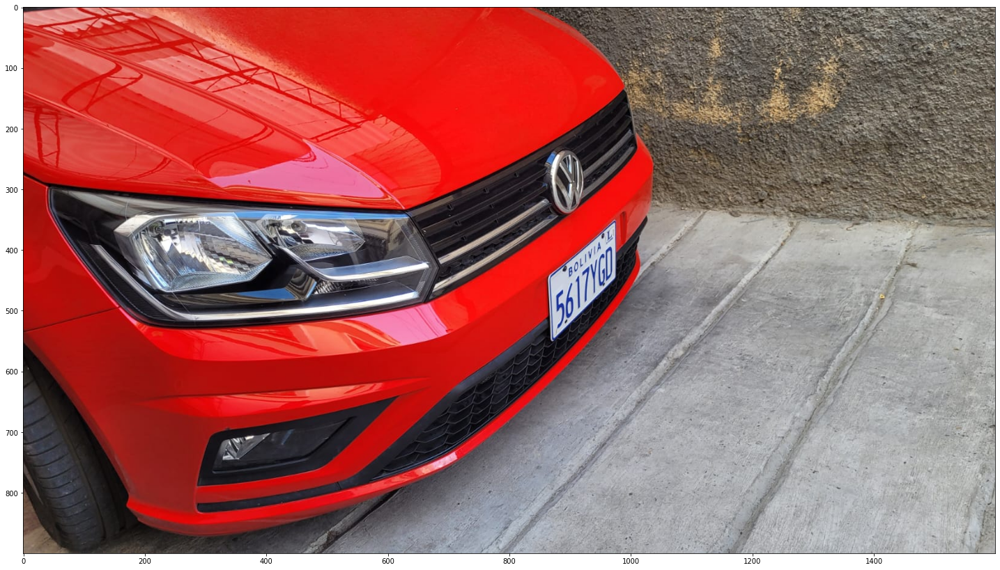

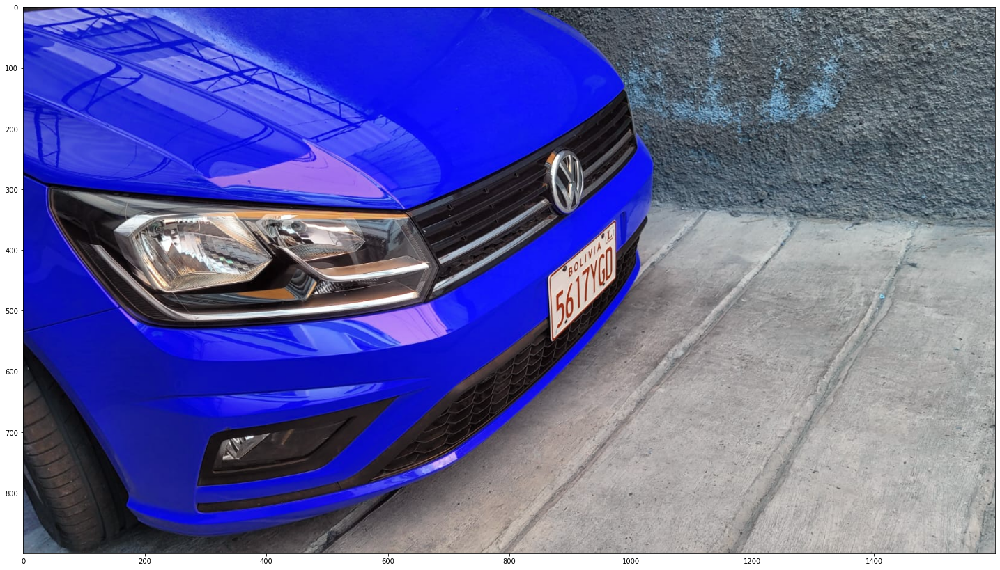

In [182]:
frame = cv2.imread(file_name)
frame_copy = np.copy(frame)
frame_copy_r = np.copy(frame_copy[:,:,2])
frame_copy_g = np.copy(frame[:,:,1])
frame_copy_b = np.copy(frame_copy[:,:,0])
frame_copy[:,:,0] = frame_copy_r[:,:]
frame_copy[:,:,2] = frame_copy_b[:,:]
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame)
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_copy)

A continuación se muestra las imagenes descompuesta en todos sus colores, en sus tonos rojos, verdes y azules, los cuales solo son matrices.

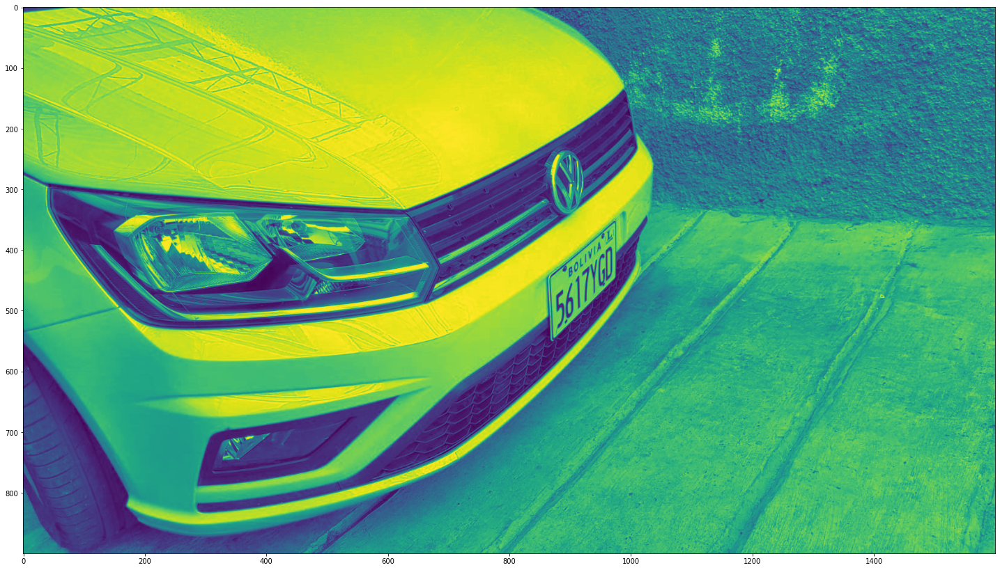

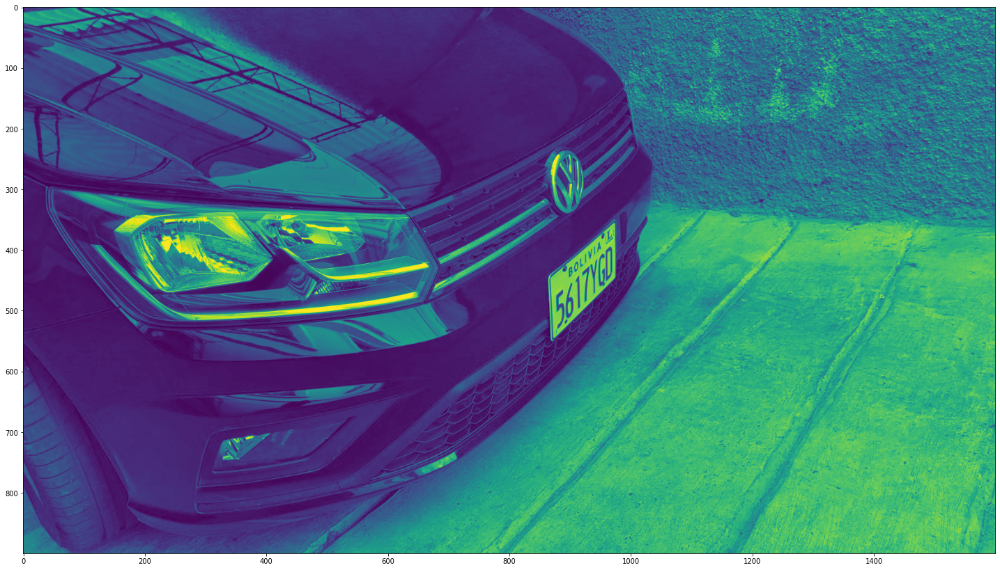

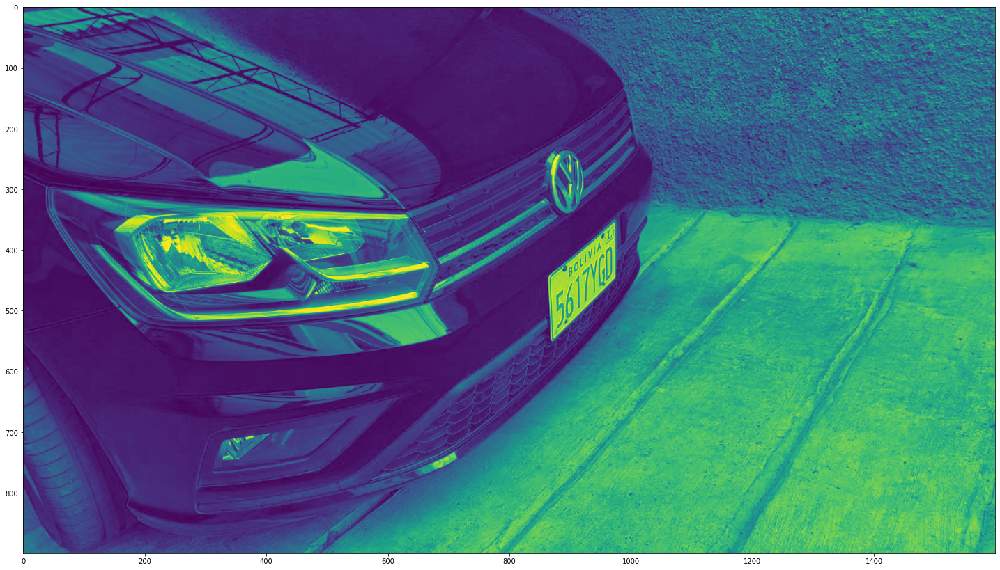

In [183]:
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_copy_r)
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_copy_g)
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_copy_b)

# Métodos de apoyo a usar

El siguiente método devuelve la intersección entre dos líneas, dichas líneas representadas como dos puntos, uno de inicio y otro de fin de cada línea.
La entrada de este metodo son dos tuplas correspondientes a cada línea, cada línea es una tupla de dos tuplas donde cada tupla dentro de las líneas corresponden a un punto de la línea (x, y).
Ej:
```
line1 = ((x1, y1), (x2, y2))
```

Y la salida de este metodo son los puntos de intersección de dichas líneas en forma de lista.

In [184]:
def line_intersection(line1, line2):
    xdiff = (line1[0][0] - line1[1][0], line2[0][0] - line2[1][0])
    ydiff = (line1[0][1] - line1[1][1], line2[0][1] - line2[1][1])

    def det(a, b):
        return a[0] * b[1] - a[1] * b[0]

    div = det(xdiff, ydiff)
    d = (det(*line1), det(*line2))
    x = det(d, xdiff) / div
    y = det(d, ydiff) / div
    return [round(x), round(y)]

Este método encuentra las intersecciones de un conjunto de líneas, para ello recibe como entrada una lista de listas de listas.
Ej:
```
lineas=[[[x1, y1, x2, y2]], [[x3, y3, x4, y4]], ...]
```
Este método devuelve una lista con todos los puntos interseccionados.

In [185]:
def get_points_intersections(lineas):
    points = []
    pos = 0
    for line in lineas:
        for i in range(len(lineas) - pos - 1):
            dx1 = line[0][2] - line[0][0]
            dy1 = line[0][3] - line[0][1]
            dx2 = lineas[i+1 + pos][0][2] - lineas[i+1+ pos][0][0]
            dy2 = lineas[i+1+ pos][0][3] - lineas[i+1+ pos][0][1]
            cosAngle = abs((dx1 * dx2 + dy1 * dy2) / math.sqrt((dx1 * dx1 + dy1 * dy1) * (dx2 * dx2 + dy2 * dy2)))
            threshold = 0.9
            if(cosAngle < threshold):
                points.append(line_intersection(((line[0][2], line[0][3]), (line[0][0], line[0][1])), ((lineas[i+1+ pos][0][2], lineas[i+1+ pos][0][3]), (lineas[i+1+ pos][0][0], lineas[i+1+ pos][0][1]))))
        pos+=1
    return np.array(points)


El siguiente se utiliza para ordenar los puntos en sentido horario, esto será útil al momento de craer la matriz de transformación que se utilizará para cambiar la perspectiva de la imagen, recibe como entrada los puntos que se quiere ordenar y devuelve la misma lista de puntos pero ordenadas.
La entrada y la salida tienen el mismo formato:
```
pts=[[x1, y1], [x2, y2], ...]
```

In [186]:
def sort_points(pts):
	rect = np.zeros((4, 2), dtype="float32")
	s = pts.sum(axis=1)
	rect[0] = pts[np.argmin(s)]
	rect[2] = pts[np.argmax(s)]
	diff = np.diff(pts, axis=1)
	rect[1] = pts[np.argmin(diff)]
	rect[3] = pts[np.argmax(diff)]
	return rect

# Tratamiento de la imagen

Lo primero que se debe hacer es intentar discriminar la placa, esto se hará según los colores de las placas que casi llegan a un color blanco, para esto se utiliza un "threshold", que para este proyecto se utilizó un valor de 190, este "threshold" es un valor entre 0 y 255 donde un valor más pequeño significa que permitirá una mayor cantidad de colores oscuros y un valor más grande permitirá colores más cercanos al blanco.

Con esto se obtendrá dos imágenes, la primera es con la placa y algo de ruido discriminado con el color negro y el resto con blaco y la siguiente imagen con los colores invertidos, cabe recalcar que estas imaenes son imagenes bianrias, es decir, que solo contienen colores negros o blancos.

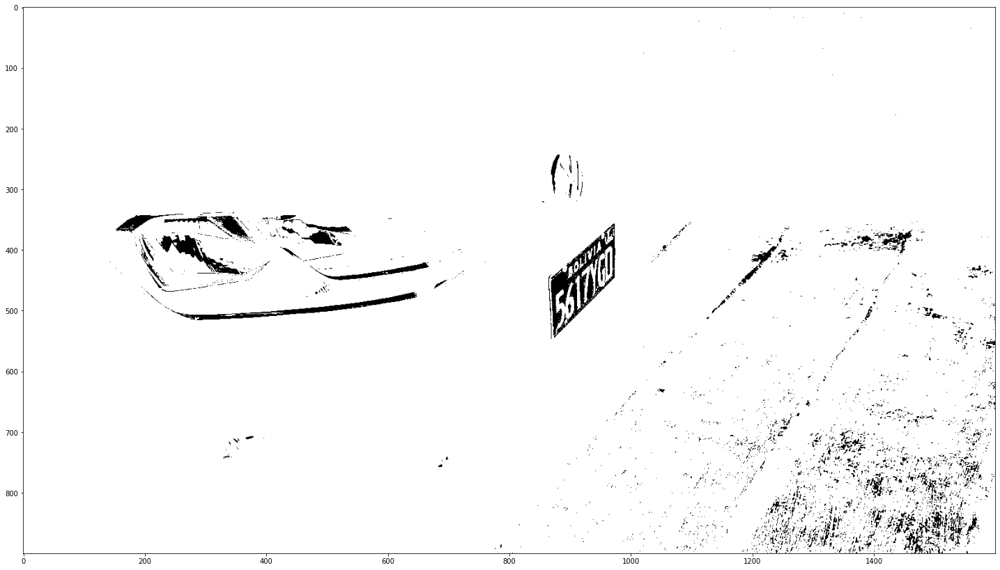

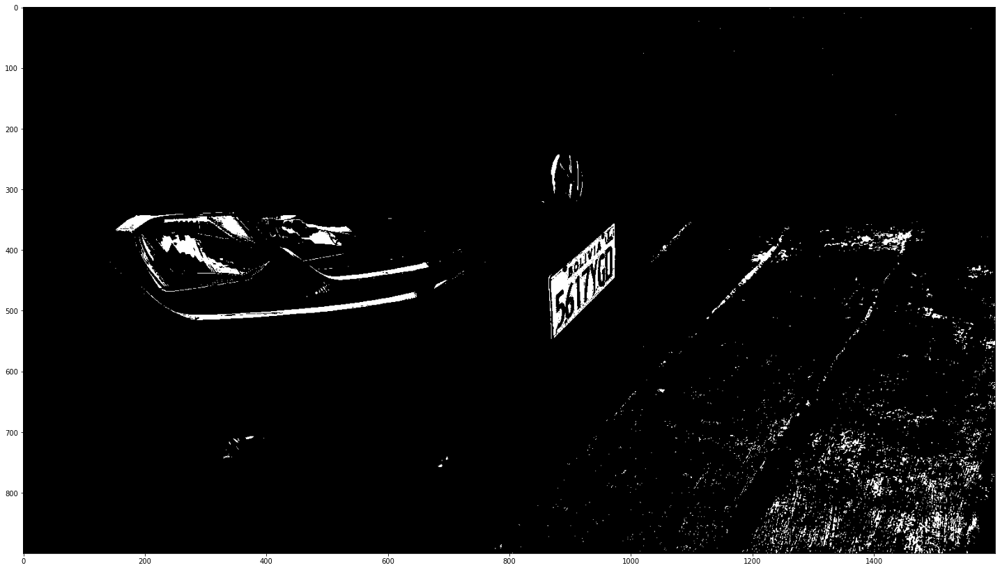

In [187]:
frame = cv2.imread(file_name)
frame_copy = np.copy(frame)
frame_copy = cv2.cvtColor(frame_copy, cv2.COLOR_BGR2RGB)
frame_copy_r = np.copy(frame_copy[:,:,0])
frame_copy_g = np.copy(frame[:,:,1])
frame_copy_b = np.copy(frame_copy[:,:,2])
threshold = 190
for i in range(len(frame_copy)):
    for j in range(len(frame_copy[0])):
        if frame_copy_r[i][j] > threshold and frame_copy_g[i][j] > threshold and frame_copy_b[i][j] > threshold:
            frame_copy_r[i][j] = 0
            frame_copy_g[i][j] = 0
            frame_copy_b[i][j] = 0
        else:
            frame_copy_r[i][j] = 255
            frame_copy_g[i][j] = 255
            frame_copy_b[i][j] = 255
binary_frame=np.copy(frame)
binary_frame[:,:,0] = frame_copy_r[:,:]
binary_frame[:,:,1] = frame_copy_g[:,:]
binary_frame[:,:,2] = frame_copy_b[:,:]

fig, ax = plt.subplots(figsize=(25,35))
binary_frame = cv2.cvtColor(binary_frame, cv2.COLOR_RGB2GRAY)
ax.imshow(binary_frame, cmap="gray")
fig, ax = plt.subplots(figsize=(25,35))
binary_frame = 255 - binary_frame
ax.imshow(binary_frame, cmap="gray")

Una vez obtenidas la imagen en binario se le aplicarán dos filtros hasta lograr obtener una imagen limpia de ruido, estos dos filtros son erode y dilate, erodo lo que hace es reducir la cantidad de pedazos en color blanco y dependiendo del kernel escogido se eliminaran pedazos más grandes o más pequeños. Mientras que dilate hace lo contrario, es decir que agranda la cantidad de partes blancas y esto lo hace con un kernel que mientras más grande este convertirá pedazos más grandes a blanco.

Antes de esto se aplica el filtro de Median Blur que sirve para reducir pequeños pedazos de ruido, es decir puntos blancos los va trnaformando a negro todo esto dependiendo al kernel que se le aplica.

Finalmente a la imagen resultante se le aplica el filtro Gaussiano para difuminar los bordes e intentar eliminar eso bordes en forma de "sierra".

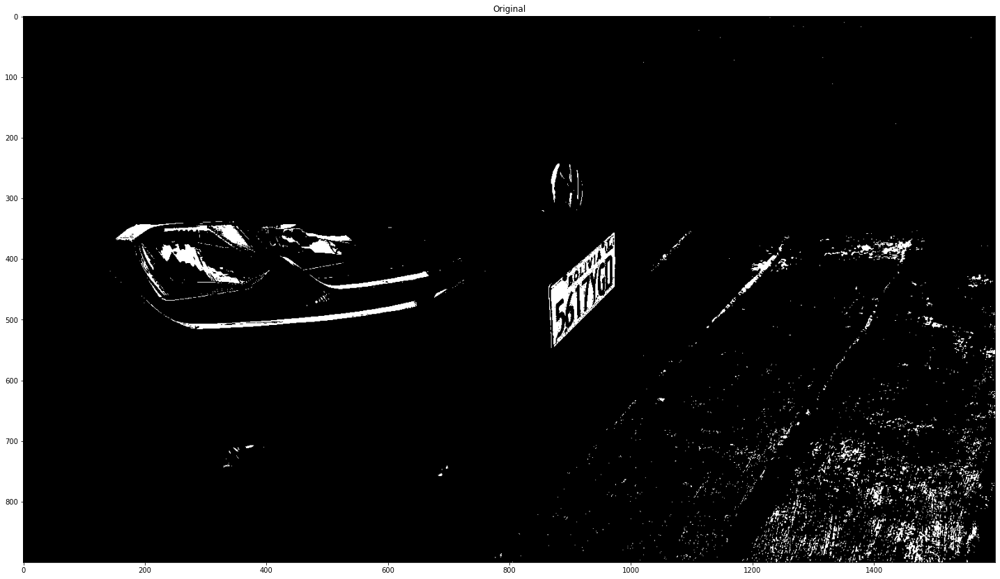

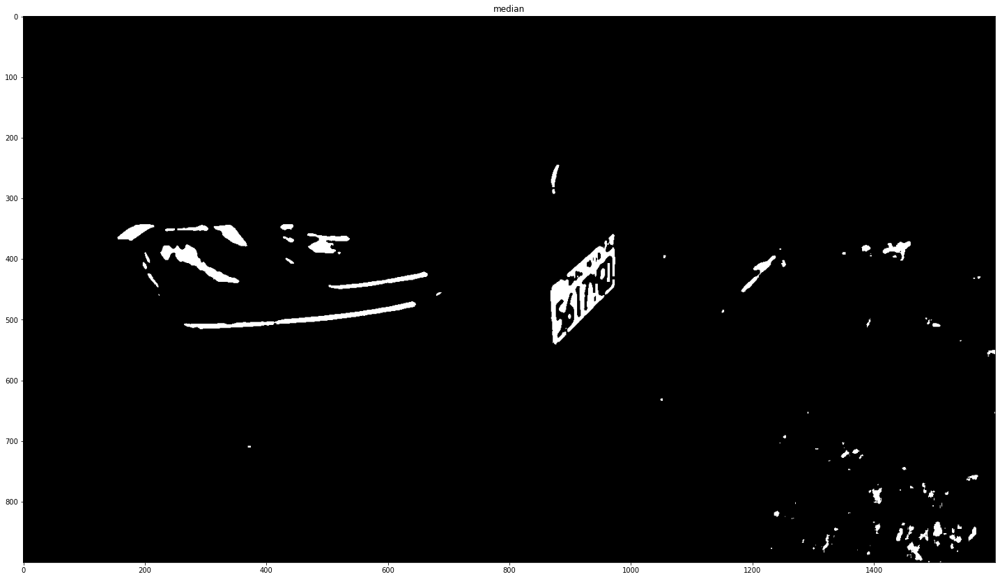

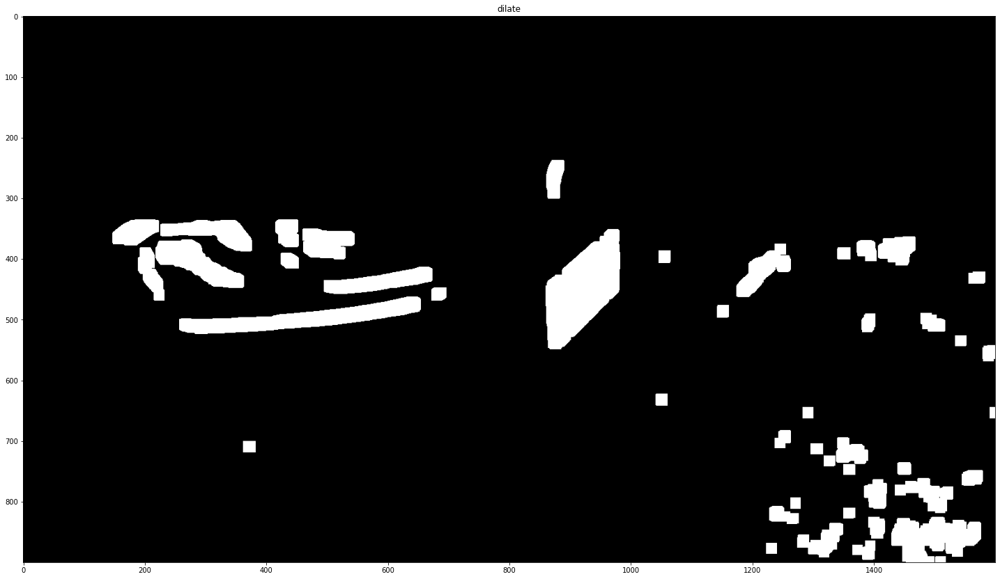

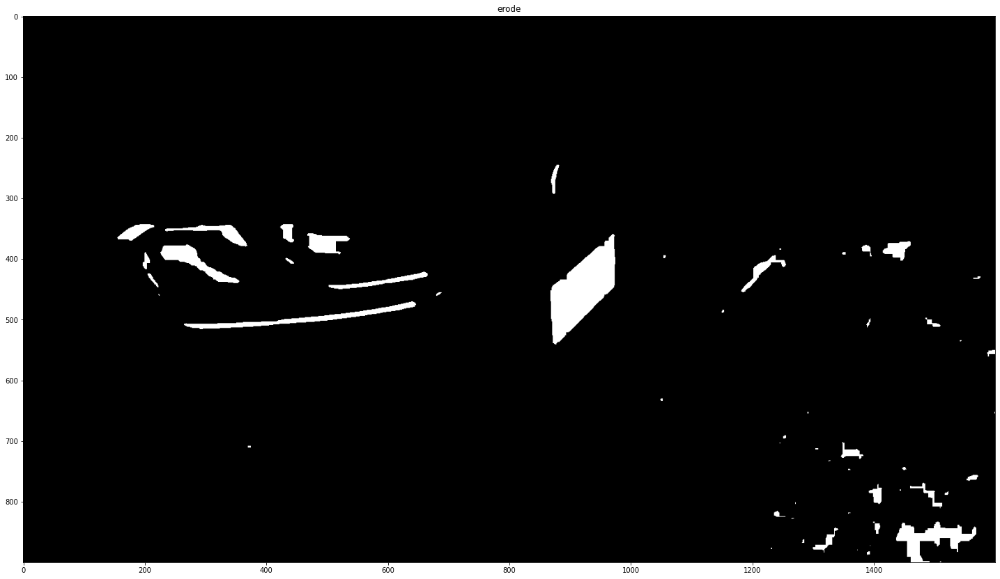

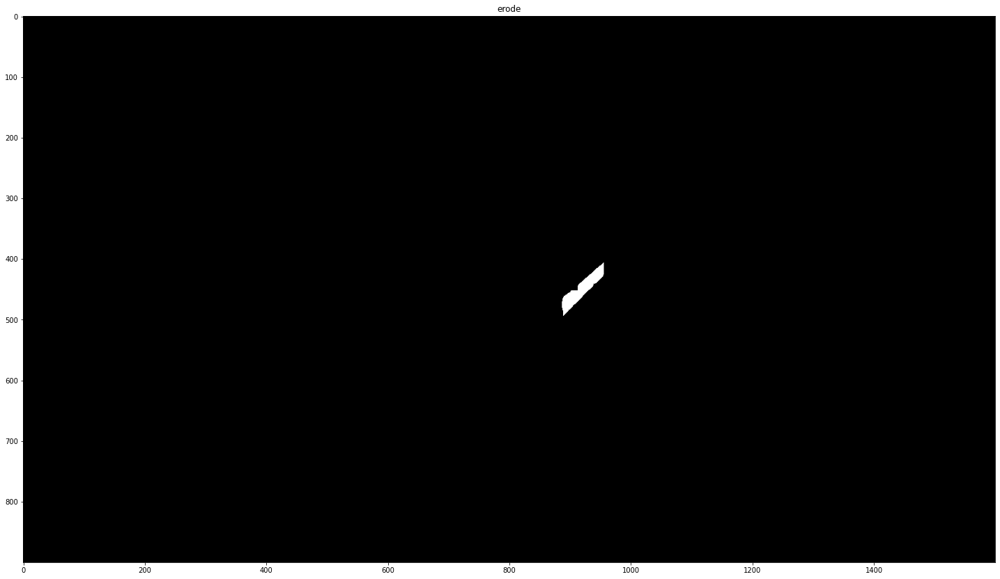

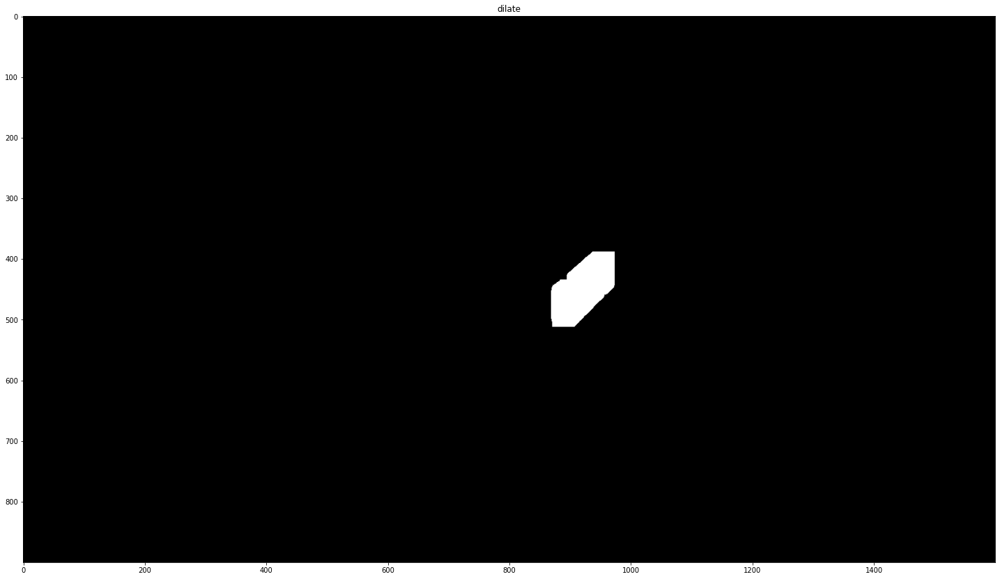

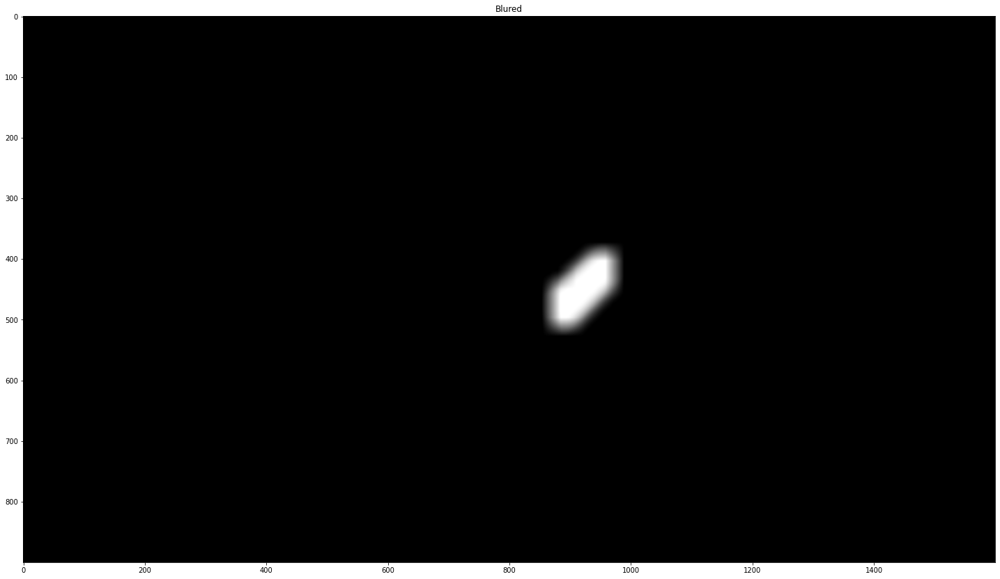

In [189]:
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('Original')
ax.imshow(binary_frame, cmap="gray")

median_blur = cv2.medianBlur(binary_frame, 7)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('median')
ax.imshow(median_blur, cmap="gray")

kernel = np.ones((17,17), np.uint8)
img_dilation = cv2.dilate(median_blur, kernel, iterations=1)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('dilate')
ax.imshow(img_dilation, cmap="gray")

img_erosion = cv2.erode(img_dilation, kernel, iterations=1)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('erode')
ax.imshow(img_erosion, cmap="gray")

kernel = np.ones((37,37), np.uint8)
# kernel = crux_matrix
img_erosion = cv2.erode(img_erosion, kernel, iterations=1)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('erode')
ax.imshow(img_erosion, cmap="gray")

img_dilation = cv2.dilate(img_erosion, kernel, iterations=1)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('dilate')
ax.imshow(img_dilation, cmap="gray")

img_filtered = cv2.GaussianBlur(img_dilation, (31, 31), 90)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('Blured')
ax.imshow(img_filtered, cmap="gray")

Despues de haber obtenido la imagen con los bordes difuminados se transforma todo los bordes a blanco y se le vuelve a aplicar erode. Para finalizar se le aplica el algoritmo de Canny el cual encuentra los bordes de una imagen, esto lo hace con el cambio repentino de tonos negros y blancos y los reslata.

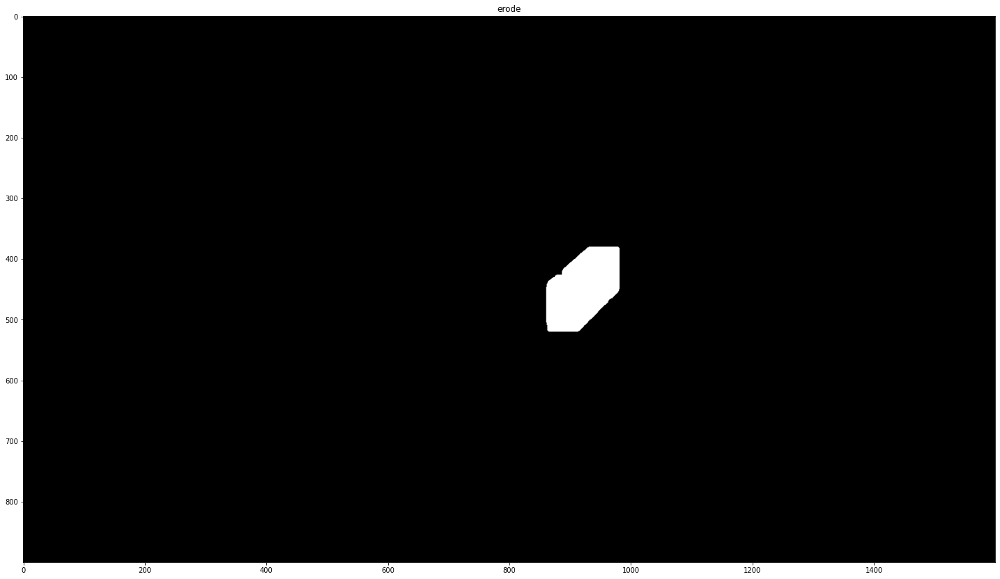

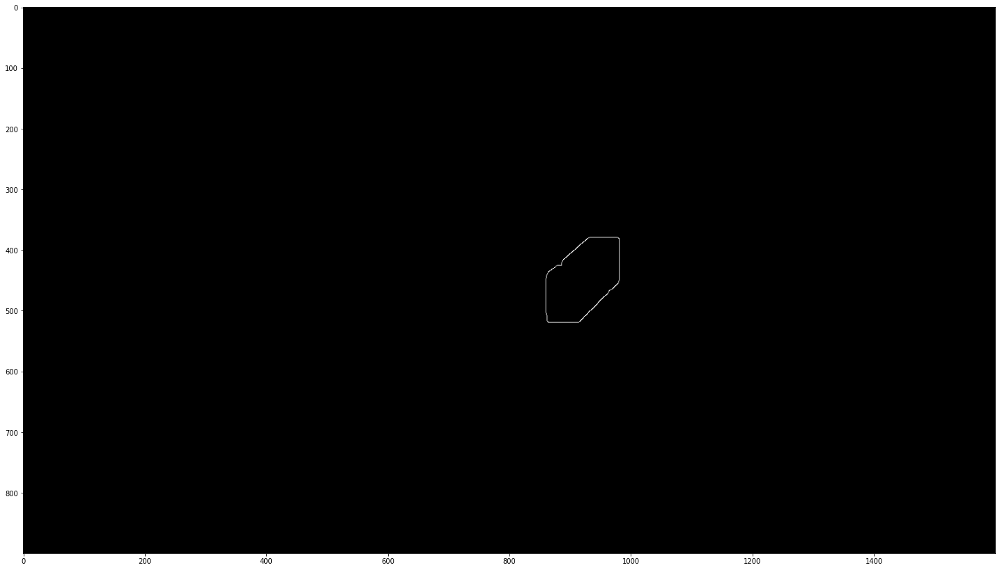

In [190]:
img_filtered[img_filtered != 0] = 255

kernel = np.ones((15,15), np.uint8)
img_erosion = cv2.erode(img_filtered, kernel, iterations=1)
fig, ax = plt.subplots(figsize=(25,35))
ax.title.set_text('erode')
ax.imshow(img_erosion, cmap="gray")

fig, ax = plt.subplots(figsize=(25,35))
canny_img = cv2.Canny(img_erosion, 0, 20)
ax.imshow(canny_img, cmap="gray")


Una vez con la imagen con bordes obtenida se le aplica la tranformada de Hough, donde cada pixel que sería un punto en nuestro espacio se tranforma a una linea en el espacio de Hough y también al reves, es decir, cada linea de nuestro espacio es un punto en el espacio de Hough. Todo esto se hace con coordenadas polares, también se le aplica un threshold para la intersección de los pixeles en el espacio de Hough, ya que como la imagen no son poligonos perfectos entonces pueden haber varias lineas en la imagen final lo cual no es lo deseado. Al final de esto se obtendrán 4 líneas que corresponderán a cada lado de la placa.

[[[914 519 980 453]]

 [[981 450 981 381]]

 [[863 439 932 379]]

 [[860 503 860 447]]]


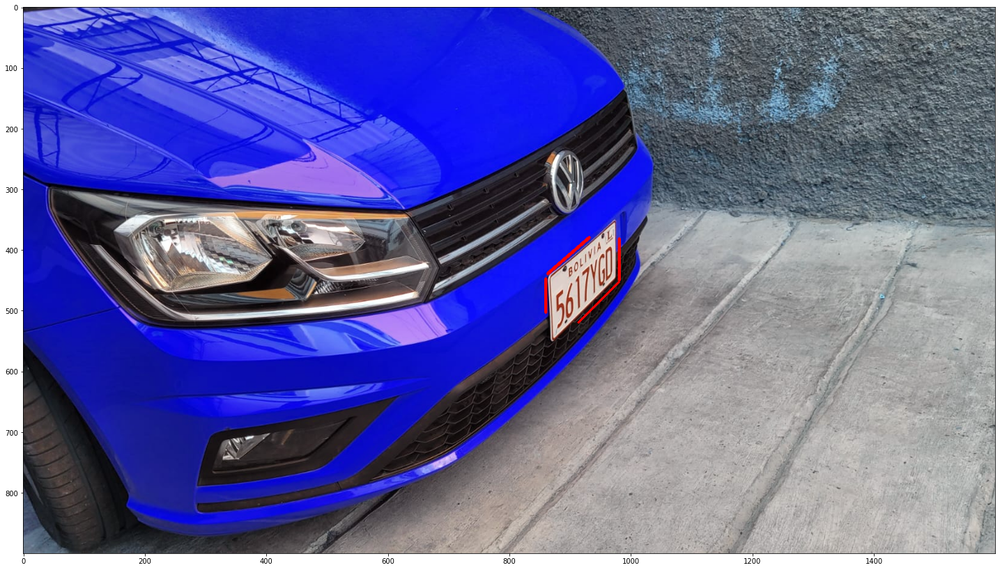

In [191]:
max_rho =  math.ceil(math.sqrt(frame.shape[0]**2+frame.shape[1]**2))
min_rho = -max_rho
min_theta = 0
max_theta = math.pi
theta = 1 * math.pi / 180
threshold = 35
frame_with_lines = np.array(frame)
lines = cv2.HoughLinesP(canny_img, 1, np.pi/180, threshold, minLineLength=10, maxLineGap=250)
while len(lines) != 4:
    if len(lines) > 4:
        threshold += 5
        lines = cv2.HoughLinesP(canny_img, 1, np.pi/180, threshold, minLineLength=10, maxLineGap=250)
    else:
        threshold -= 5
        lines = cv2.HoughLinesP(canny_img, 1, np.pi/180, threshold, minLineLength=10, maxLineGap=250)
print(lines)
for line in lines:
    x1, y1, x2, y2 = line[0]
    # plt.plot([x1, x2], [y1,y2], 'r')
    cv2.line(frame_with_lines, (x1, y1), (x2, y2), (255, 0, 0), 3)
# plt.show
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_with_lines)

Ahora, con las líneas encontradas y los métodos mecionados al principio se obtiene las intersecciones de las lineas para obtener las esquinas de la placa y así poder hacer una transformación correcta de la imagen.

In [192]:
points = sort_points(get_points_intersections(lines))
points

array([[860., 442.],
       [981., 336.],
       [981., 452.],
       [860., 573.]], dtype=float32)

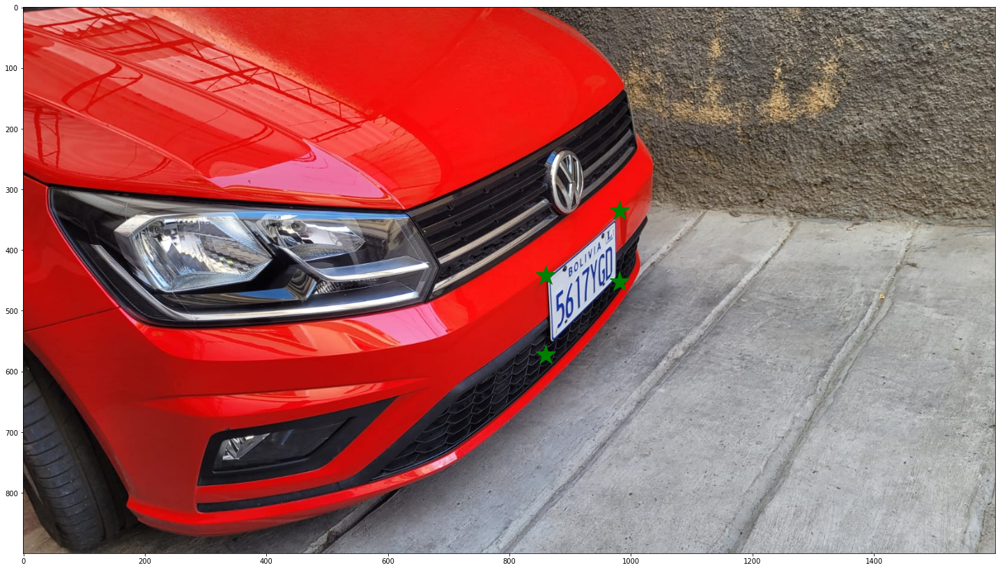

In [193]:
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(frame_copy)
x = points[:,0]
y = points[:,1]
ax.plot(x,y, 'g*', markersize=30)

Con el método "warpPerspective" se le aplica una matriz de tranformación que se obtiene con los puntos de intersección de las lineas y unos puntos de referencia, con esto se puede "aplanar" la imagen para tener la placa de frente.

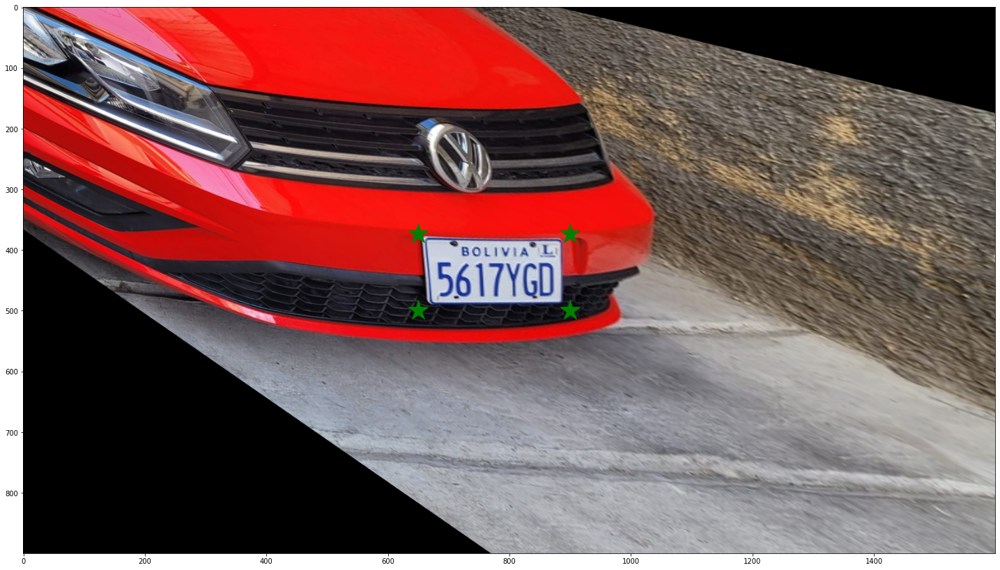

In [195]:
img = np.copy(frame_copy)
src_points = np.float32([points[0], points[1], points[2], points[3]])
dst_points = np.float32([[650, 373], [900, 373], [900, 500], [650, 500]])
projective_matrix = cv2.getPerspectiveTransform(src_points, dst_points)
img_output = cv2.warpPerspective(img, projective_matrix, (frame.shape[1],frame.shape[0]))
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(img_output)
x = dst_points[:,0]
y = dst_points[:,1]
ax.plot(x,y, 'g*', markersize=30)

Despues se procede a recortar la imagen y asi tenerla en grande, ya con esto se podría intentar predecir los valores que tiene la placa con una red neuronal o con otros métodos.

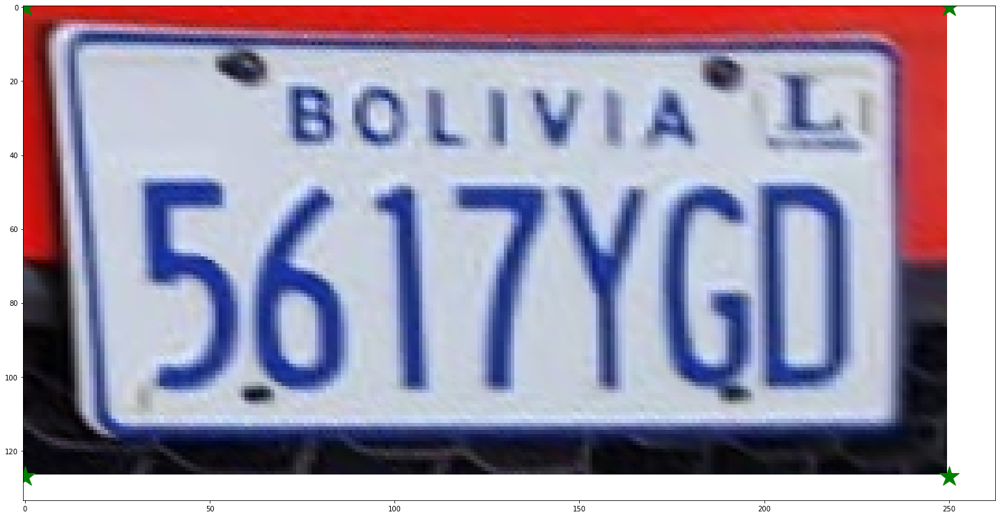

In [196]:
plate = img_output[373:500, 650:900]
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(plate)
x = dst_points[:,0]-650
y = dst_points[:,1]-373
ax.plot(x,y, 'g*', markersize=30)

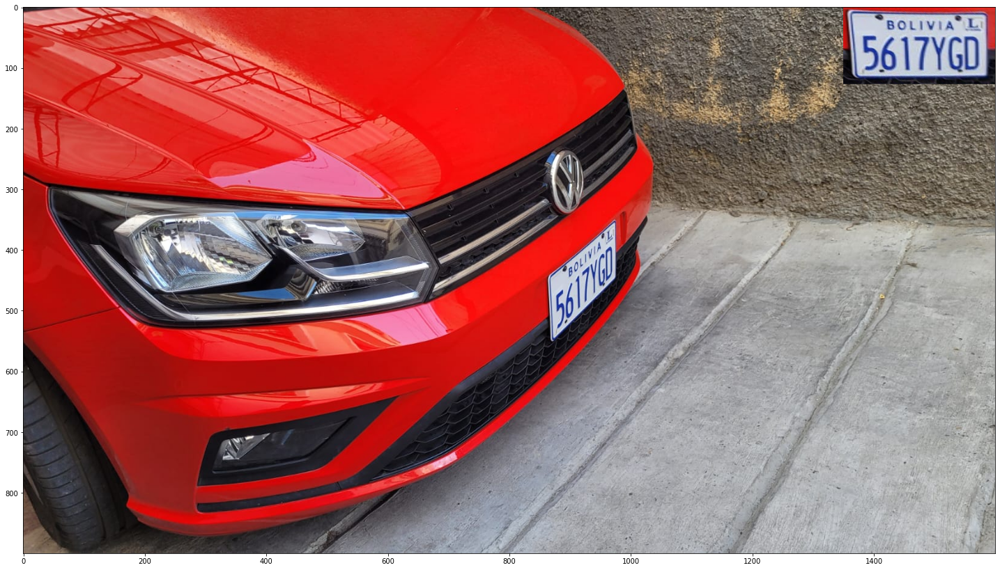

In [197]:
finished_image = np.copy(frame_copy)
finished_image[:plate.shape[0], width - plate.shape[1]:,:] = plate
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(finished_image)

Y para finalizar con la máscara obtenida con la imagen binaria se puede resaltar el área de la placa que se tiene.

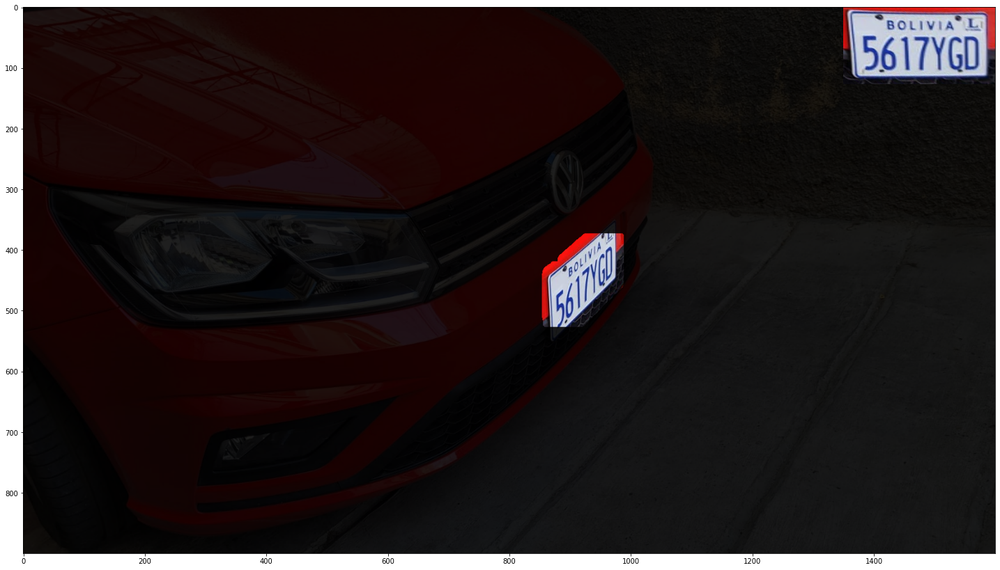

In [198]:
mask = np.copy(img_filtered)
mask = np.float16(mask)
mask[mask[:,:] == 0] = 1/8
mask[mask[:,:] == 255] = 1
masked_img = np.copy(finished_image)
masked_img[:,:,0] = masked_img[:,:,0]*mask
masked_img[:,:,1] = masked_img[:,:,1]*mask
masked_img[:,:,2] = masked_img[:,:,2]*mask
masked_img[:plate.shape[0], width - plate.shape[1]:,:] = plate
fig, ax = plt.subplots(figsize=(25,35))
ax.imshow(masked_img)